In [53]:
import pandas as pd
import os
import sidetable as stb
os.environ['REPO'] = '/Users/greengodfitness/Desktop/TechFit/ds_project'
os.chdir(os.environ['REPO'])
from scipy import stats
import numpy as np
from sklearn.model_selection import train_test_split, RandomizedSearchCV
import warnings
import datetime
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import IPython
import IPython.display
from IPython.display import Image, HTML
import copy
from time import time
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.graph_objects as go
from varname import nameof

In [20]:
warnings.filterwarnings("ignore")
init_notebook_mode(connected=True)

### Data Preprocessing

In [14]:
df = pd.read_csv('data/project_data.csv')

temp_cols = [col for col in df.columns if 'temp' in col] 
rain_cols = [col for col in df.columns if 'rain' in col]
msl_cols = [col for col in df.columns if 'msl' in col]
dewpt_cols = [col for col in df.columns if 'dewpt' in col]
rhum_cols = [col for col in df.columns if 'rhum' in col]
wdsp_cols = [col for col in df.columns if 'wdsp' in col]
wddir_cols = [col for col in df.columns if 'wddir' in col]
dir_cols = [col for col in df.columns if 'dir' in col]
windsp_cols = [col for col in df.columns if 'windsp' in col]
seatp_cols = [col for col in df.columns if 'seatp' in col]
df['temp'] = df[temp_cols].mean(axis=1)
df['rain'] = df[rain_cols].mean(axis=1)
df['msl'] = df[msl_cols].mean(axis=1)
df['dewpt'] = df[dewpt_cols].mean(axis=1)
df['rhum'] = df[rhum_cols].mean(axis=1)
df['wdsp'] = df[wdsp_cols].mean(axis=1)
df['wddir'] = df[wddir_cols].mean(axis=1)
df['dir'] = df[dir_cols].mean(axis=1)
df['windsp'] = df[windsp_cols].mean(axis=1)
df['seatp'] = df[seatp_cols].mean(axis=1)
dataset = df[['date','temp','rain','msl','dewpt','rhum','wdsp','wddir','dir','demand']]

# Find missing values
dataset.isnull().any().any()
missing = dataset.stb.missing()
missing = dataset.stb.missing()
missing['cols'] = missing.index

def fill_missing_values(unfilled_data, missing=missing):
    threshold_below_5 = missing.loc[(missing['Percent']>0)&(missing['Percent']<0.005)]
    unfilled_data[threshold_below_5.cols] = unfilled_data[threshold_below_5.cols].apply(lambda x: x.interpolate(method = 'linear'))
    return unfilled_data

complete_dataset = fill_missing_values(dataset)

# Handling Outliers
def remove_outliers(skewed_dataset=complete_dataset):
    skewed_desc = skewed_dataset.iloc[:,0:10].describe()
    skewed_dataset['date'] = pd.to_datetime(skewed_dataset['date'],format='%Y-%m-%d %H:%M:%S')
    skewed_dataset.set_index('date', inplace=True)
    z = (np.abs(stats.zscore(skewed_dataset.iloc[:,0:10])) >= 4)
    unskewed_dataset = skewed_dataset.iloc[:,0:10].mask(z).interpolate(method = 'linear')
    return unskewed_dataset

model_dataset = remove_outliers(complete_dataset)
model_dataset

,temp,rain,msl,dewpt,rhum,wdsp,wddir,dir,demand
date,,,,,,,,,
2014-01-01 00:00:00,5.420,0.168,988.884,3.132,85.08,11.608696,188.260870,188.260870,2845.3
2014-01-01 01:00:00,5.172,0.040,988.520,3.160,86.80,11.304348,184.782609,184.782609,2637.6
2014-01-01 02:00:00,5.148,0.020,987.928,3.336,87.80,11.043478,172.608696,172.608696,2413.3
2014-01-01 03:00:00,5.148,0.100,987.124,3.448,88.56,11.000000,167.826087,167.826087,2251.6
2014-01-01 04:00:00,5.040,0.116,985.884,3.532,89.72,11.000000,161.739130,161.739130,2132.2
...,...,...,...,...,...,...,...,...,...
2020-07-31 19:00:00,16.576,0.096,1008.504,13.800,83.80,9.217391,248.695652,248.695652,3440.6
2020-07-31 20:00:00,15.652,0.024,1009.160,13.456,86.68,7.782609,251.739130,251.739130,3291.4
2020-07-31 21:00:00,15.016,0.008,1010.024,13.228,88.84,7.130435,250.000000,250.000000,3226.8


### Feature Engineering

In [21]:
model_dataset['date_time'] = model_dataset.index
date_time = pd.to_datetime(model_dataset.pop('date_time'), format='%d.%m.%Y %H:%M:%S')
timestamp_s = date_time.map(datetime.datetime.timestamp)

# Feature engineering
day = 24*60*60
year = (365.2425)*day
model_dataset['Day sin'] = np.sin(timestamp_s * (2 * np.pi / day))
model_dataset['Day cos'] = np.cos(timestamp_s * (2 * np.pi / day))
model_dataset['Year sin'] = np.sin(timestamp_s * (2 * np.pi / year))
model_dataset['Year cos'] = np.cos(timestamp_s * (2 * np.pi / year))

In [22]:
wv = model_dataset.pop('wdsp')

# Convert to radians.
wd_rad = model_dataset.pop('wddir')*np.pi / 180

# Calculate the wind x and y components.
model_dataset['Wx'] = wv*np.cos(wd_rad)
model_dataset['Wy'] = wv*np.sin(wd_rad)

In [74]:
data = model_dataset[['temp', 'rain', 'msl', 'dewpt', 'rhum','Day sin','Day cos','Year sin','Year cos','Wx','Wy','demand']]

# Split the dataset
column_indices = {name: i for i, name in enumerate(data.columns)}
n = len(data)
train_df = data[0:int(n*0.8)]
val_df = data[int(n*0.8):int(n*0.9)]
test_df = data[int(n*0.9):]
num_features = data.shape[1]

# Unseen Dataset for prediciton
a_future_pred = test_df[-24:]
a_pred_df_actual = test_df[-48:-24:]
a_pred_df_xg = test_df[-48:-24:]

test_df = test_df[:-48]

### Modeling

In [24]:
data.head()

,temp,rain,msl,dewpt,rhum,Day sin,Day cos,Year sin,Year cos,Wx,Wy,demand
date,,,,,,,,,,,,
2014-01-01 00:00:00,5.420,0.168,988.884,3.132,85.08,-1.067931e-11,1.000000,0.005677,0.999984,-11.488246,-1.667942,2845.3
2014-01-01 01:00:00,5.172,0.040,988.520,3.160,86.80,2.588190e-01,0.965926,0.006394,0.999980,-11.264988,-0.942504,2637.6
2014-01-01 02:00:00,5.148,0.020,987.928,3.336,87.80,5.000000e-01,0.866025,0.007110,0.999975,-10.951715,1.420689,2413.3
2014-01-01 03:00:00,5.148,0.100,987.124,3.448,88.56,7.071068e-01,0.707107,0.007827,0.999969,-10.752632,2.319677,2251.6
2014-01-01 04:00:00,5.040,0.116,985.884,3.532,89.72,8.660254e-01,0.500000,0.008544,0.999963,-10.446037,3.446784,2132.2


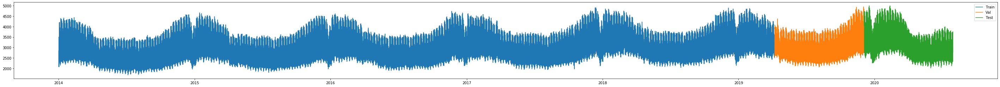

In [25]:
plt.figure(figsize=(50,4))
plt.plot(train_df.index,train_df['demand'],label='Train');
plt.plot(val_df.index,val_df['demand'],label='Val');
plt.plot(test_df.index,test_df['demand'],label='Test')
plt.legend();

### Model Evaluation

### XGBoost

XGBoost, which is short for “Extreme Gradient Boosting,” is a library that provides an efficient implementation of the gradient boosting algorithm.

The main benefit of the XGBoost implementation is computational efficiency and often better model performance.

In [28]:
import xgboost as xgb
print(xgb.__version__)

1.1.0


### Baseline

In [30]:
X_train, y_train = train_df.iloc[:,:-1], train_df.iloc[:,-1]
X_val, y_val = val_df.iloc[:,:-1], val_df.iloc[:,-1]
X_test, y_test = test_df.iloc[:,:-1], test_df.iloc[:,-1]
X_pred, y_pred = a_pred_df_xg.iloc[:,:-1], a_pred_df_xg.iloc[:,-1]
X_future_pred, y_future_pred = a_future_pred.iloc[:,:-1], a_future_pred.iloc[:,-1]

In [31]:
xgb_reg = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=1000)

In [32]:
xgb_reg = xgb_reg.fit(X_train, y_train)

In [33]:
y_pred_xg_base = xgb_reg.predict(X_test)

In [34]:
xgb_reg.score(X_test, y_test)

0.739653348267312

### Model Tuning

In [87]:
xgb_reg_2 = xgb.XGBRegressor(objective='reg:squarederror',
                         nthread = 4,
                         eta = 0.1,
                         num_boost_round = 100,
                         max_depth = 5,
                         subsample = 0.5,
                         colsample_bytree = 1.0,
                         silent = 0)

params = {
    'num_boost_round' : [10, 25, 5, 15],
    'eta' : [0.05, 0.001, 0.1, 0.3],
    'max_depth' : [3, 4, 5, 6],
    'subsample': [0.8, 0.9, 1],
    'colsample_bytree' : [0.8, 0.9, 1],
    'alpha' : [0.0, 0.1, 0.3]
}

random_search = RandomizedSearchCV(xgb_reg_2, params, n_jobs=-1, cv=5, n_iter=500, verbose=1, scoring='r2')
start = time()
random_search.fit(X_train, y_train, eval_set=[(X_train, y_train), (X_val, y_val)], early_stopping_rounds=10, verbose=True)
best_parameters = random_search.best_params_

Fitting 5 folds for each of 500 candidates, totalling 2500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  3.8min
[Parallel(n_jobs=-1)]: Done 442 tasks      | elapsed:  7.5min
[Parallel(n_jobs=-1)]: Done 792 tasks      | elapsed: 12.3min
[Parallel(n_jobs=-1)]: Done 1242 tasks      | elapsed: 18.8min
[Parallel(n_jobs=-1)]: Done 1792 tasks      | elapsed: 26.8min
[Parallel(n_jobs=-1)]: Done 2442 tasks      | elapsed: 36.6min
[Parallel(n_jobs=-1)]: Done 2500 out of 2500 | elapsed: 37.3min finished


[03:31:34] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:480: 
Parameters: { num_boost_round, silent } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[0]	validation_0-rmse:3028.58520	validation_1-rmse:3115.59595
Multiple eval metrics have been passed: 'validation_1-rmse' will be used for early stopping.

Will train until validation_1-rmse hasn't improved in 10 rounds.
[1]	validation_0-rmse:2878.61621	validation_1-rmse:2970.77710
[2]	validation_0-rmse:2736.20850	validation_1-rmse:2833.18750
[3]	validation_0-rmse:2601.21094	validation_1-rmse:2701.06250
[4]	validation_0-rmse:2473.86548	validation_1-rmse:2578.27075
[5]	validation_0-rmse:2352.15552	validation_1-rmse:2459.19556
[6]	validation_0-rmse:2236.24487	validation_1-rmse:2348.32202
[7]	validation_0-rmse:2127.36231	v

In [39]:
print('RandomizedSearchCV Results:')
print(random_search.best_score_)
print('Best Parameters: ')
for param_name in sorted(best_parameters.keys()):
    print("%s: %r" % (param_name, best_parameters[param_name]))
end = time()
print('Time elapsed: ' + str(end-start))
print(' ')
print('Best Estimator: ')
print(random_search.best_estimator_)
y_pred_xgb = random_search.predict(X_test)

RandomizedSearchCV Results:
0.7942987027006673
Best Parameters: 
alpha: 0.3
colsample_bytree: 0.9
eta: 0.05
max_depth: 5
num_boost_round: 25
subsample: 0.8
Time elapsed: 2763.7669229507446
 
Best Estimator: 
XGBRegressor(alpha=0.3, base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.9, eta=0.05, gamma=0,
             gpu_id=-1, importance_type='gain', interaction_constraints='',
             learning_rate=0.0500000007, max_delta_step=0, max_depth=5,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=4, nthread=4, num_boost_round=25,
             num_parallel_tree=1, random_state=0, reg_alpha=0.300000012,
             reg_lambda=1, scale_pos_weight=1, silent=0, subsample=0.8,
             tree_method='exact', validate_parameters=1, ...)


In [42]:
xgb_reg_3 = xgb.XGBRegressor(alpha=0.3, 
                             base_score=0.5, 
                             booster='gbtree', 
                             colsample_bylevel=1,
                             colsample_bynode=1, 
                             colsample_bytree=0.9, 
                             eta=0.05, gamma=0,
                             gpu_id=-1, 
                             importance_type='gain', 
                             interaction_constraints='',
                             learning_rate=0.0500000007, 
                             max_delta_step=0, 
                             max_depth=5,
                             min_child_weight=1, 
                             missing=None, 
                             monotone_constraints='()',
                             n_estimators=100, 
                             n_jobs=4, 
                             nthread=4, 
                             num_boost_round=25,
                             num_parallel_tree=1, 
                             random_state=0, 
                             reg_alpha=0.300000012,
                             reg_lambda=1, 
                             scale_pos_weight=1, 
                             silent=0, 
                             subsample=0.8,
                             tree_method='exact', 
                             validate_parameters=1)

In [43]:
xgb_reg_3.fit(X_train, y_train, eval_set=[(X_train, y_train), (X_val, y_val)], early_stopping_rounds=10, verbose=False)

[22:53:24] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:480: 
Parameters: { num_boost_round, silent } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.




XGBRegressor(alpha=0.3, base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.9, eta=0.05, gamma=0,
             gpu_id=-1, importance_type='gain', interaction_constraints='',
             learning_rate=0.0500000007, max_delta_step=0, max_depth=5,
             min_child_weight=1, missing=None, monotone_constraints='()',
             n_estimators=100, n_jobs=4, nthread=4, num_boost_round=25,
             num_parallel_tree=1, random_state=0, reg_alpha=0.300000012,
             reg_lambda=1, scale_pos_weight=1, silent=0, subsample=0.8,
             tree_method='exact', validate_parameters=1, ...)

In [44]:
y_pred_xg_base = xgb_reg_3.predict(X_test)

In [45]:
xgb_reg_3.score(X_test, y_test)

0.757898121760114

In [46]:
y_pred_xg = xgb_reg_3.predict(X_pred)

In [47]:
y_future_pred_xg = xgb_reg_3.predict(X_future_pred)

In [49]:
df_xg = pd.DataFrame([])
df_xg = pd.DataFrame(y_pred_xg, columns=['demand'], index=X_pred.index)
df_xg1 = pd.DataFrame([])
df_xg1 = pd.DataFrame(y_future_pred_xg, columns=['demand'], index=X_future_pred.index)

In [50]:
# Data
a_actual = a_pred_df_actual
a_train = train_df
a_val = val_df
a_test = test_df
a_actual1 = a_future_pred

# Date
a_date_train = a_train.index
a_date_val = a_val.index
a_date_test = a_test.index
a_date_actual = a_actual.index
a_date_actual1 = a_actual1.index
a_date_pred = df_xg.index
a_date_future = df_xg1.index

# Values
a_train_plot = a_train['demand'].values
a_val_plot = a_val['demand'].values
a_test_plot = a_test['demand'].values
a_actual_plot = a_actual['demand'].values
a_actual1_plot = a_actual1['demand'].values
a_pred_plot = df_xg['demand'].values
a_future_plot = df_xg1['demand'].values

In [54]:
trace1 = go.Scatter(
    x = a_date_train,
    y = a_train_plot,
    mode = 'lines',
    name = 'Training Data',
    line = dict(color=('rgb(66, 134, 244)'), width=2)
)
trace2 = go.Scatter(
    x = a_date_val,
    y = a_val_plot,
    mode = 'lines',
    name = 'Validation Data',
    line = dict(color=('rgb(0, 76, 153)'), width=2)
)
trace3 = go.Scatter(
    x = a_date_test,
    y = a_test_plot,
    mode = 'lines',
    name = 'Test Data',
    line = dict(color=('rgb(0, 153, 153)'), width=2)
)
trace4 = go.Scatter(
    x = a_date_actual,
    y = a_actual_plot,
    mode = 'lines',
    name = 'Actual Data 30/7',
    line = dict(color=('rgb(0, 0, 0)'), width=2, dash='dash')
)
trace5 = go.Scatter(
    x = a_date_actual1,
    y = a_actual1_plot,
    mode = 'lines',
    name = 'Actual Data 31/7',
    line = dict(color=('rgb(0, 0, 0)'), width=2, dash='dash')
)
trace6 = go.Scatter(
    x = a_date_pred,
    y = a_pred_plot,
    mode = 'lines',
    name = 'Prediction Data 30/7',
    line = dict(color=('rgb(255, 102, 102)'), width=2)
)
trace7 = go.Scatter(
    x = a_date_future,
    y = a_future_plot,
    mode = 'lines',
    name = 'Prediction Data 31/7',
    line = dict(color=('rgb(255, 102, 102)'), width=2)
)
data = [trace1,trace2,trace3,trace4,trace5,trace6,trace7]
layout = go.Layout(
    title = "Predictions",
    xaxis = {'title' : "Date"},
    yaxis = {'title' : "Demand"}
)
fig = go.Figure(data=data, layout=layout)
fig.show()


### LightGBM

LightGBM, short for Light Gradient Boosted Machine, is a library developed at Microsoft that provides an efficient implementation of the gradient boosting algorithm.

The primary benefit of the LightGBM is the changes to the training algorithm that make the process dramatically faster, and in many cases, result in a more effective model.

In [56]:
import lightgbm as lgbm
print(lgbm.__version__)

3.1.1


### Baseline

In [57]:
lgbm_reg = lgbm.LGBMRegressor(n_estimators=1000)

In [58]:
lgbm_reg.fit(X_train, y_train)

LGBMRegressor(n_estimators=1000)

In [59]:
y_pred_lgbm_base = lgbm_reg.predict(X_test)

In [60]:
lgbm_reg.score(X_test, y_test)

0.7570414879917539

### Model Tuning

In [61]:
lgbm_reg_2 = lgbm.LGBMRegressor(
                         nthread = 4,
                         learning_rate = 0.1,
                         num_leaves = 31,
                         max_depth = 5,
                         subsample = 0.5,
                         colsample_bytree = 1.0,
                         n_estimators=1000)


params = {
    'min_child_samples' : [10, 20, 25, 55],
    'learning_rate' : [0.05, 0.001, 0.1, 0.3],
    'n_estimators' : [10, 25, 5, 15],
    'max_depth' : [3, 4, 5, 6],
    'subsample': [0.8, 0.9, 1],
    'colsample_bytree' : [0.8, 0.9, 1],
    'reg_alpha' : [0.0, 0.1, 0.3],
    'min_child_weight' : [0.05, 0.01, 0.1, 0.3],
    'num_leaves' : [31, 41, 51, 61]
}

random_search = RandomizedSearchCV(lgbm_reg_2, params, n_jobs=-1, cv=5, n_iter=500, verbose=1, scoring='r2')
start = time()
random_search.fit(X_train, y_train, eval_set=[(X_train, y_train), (X_val, y_val)], early_stopping_rounds=10, verbose=True)
best_parameters = random_search.best_params_ 

Fitting 5 folds for each of 500 candidates, totalling 2500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   23.1s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:   34.4s
[Parallel(n_jobs=-1)]: Done 442 tasks      | elapsed:   53.7s
[Parallel(n_jobs=-1)]: Done 792 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 1242 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done 1792 tasks      | elapsed:  2.5min
[Parallel(n_jobs=-1)]: Done 2442 tasks      | elapsed:  3.2min


[LightGBM] [Warning] num_threads is set with nthread=4, will be overridden by n_jobs=-1. Current value: num_threads=-1
[1]	training's l2: 221992	valid_1's l2: 208861
Training until validation scores don't improve for 10 rounds
[2]	training's l2: 145333	valid_1's l2: 144227
[3]	training's l2: 106051	valid_1's l2: 113574
[4]	training's l2: 86251.8	valid_1's l2: 100817
[5]	training's l2: 75220.7	valid_1's l2: 94984.1
[6]	training's l2: 68980.3	valid_1's l2: 92771.2
[7]	training's l2: 65445.7	valid_1's l2: 91631.9
[8]	training's l2: 63173	valid_1's l2: 91774.2
[9]	training's l2: 61607.1	valid_1's l2: 91805.3
[10]	training's l2: 60443	valid_1's l2: 92064.1
Did not meet early stopping. Best iteration is:
[10]	training's l2: 60443	valid_1's l2: 92064.1


[Parallel(n_jobs=-1)]: Done 2500 out of 2500 | elapsed:  3.3min finished


In [62]:
print('RandomizedSearchCV Results:')
print(random_search.best_score_)
print('Best Parameters: ')
for param_name in sorted(best_parameters.keys()):
    print("%s: %r" % (param_name, best_parameters[param_name]))
end = time()
print('Time elapsed: ' + str(end-start))
print(' ')
print('Best Estimator: ')
print(random_search.best_estimator_)
y_pred_lgbm = random_search.predict(X_test)

RandomizedSearchCV Results:
0.7921809005615469
Best Parameters: 
colsample_bytree: 1
learning_rate: 0.3
max_depth: 5
min_child_samples: 20
min_child_weight: 0.1
n_estimators: 10
num_leaves: 41
reg_alpha: 0.3
subsample: 0.8
Time elapsed: 363.73376417160034
 
Best Estimator: 
LGBMRegressor(colsample_bytree=1, learning_rate=0.3, max_depth=5,
              min_child_weight=0.1, n_estimators=10, nthread=4, num_leaves=41,
              reg_alpha=0.3, subsample=0.8)


In [63]:
lgbm_reg_3 = lgbm.LGBMRegressor(colsample_bytree=1, learning_rate=0.3, max_depth=5,
              min_child_weight=0.1, n_estimators=10, nthread=4, num_leaves=41,
              reg_alpha=0.3, subsample=0.8)

In [64]:
lgbm_reg_3.fit(X_train, y_train, eval_set=[(X_train, y_train), (X_val, y_val)], early_stopping_rounds=10, verbose=False)

[LightGBM] [Warning] num_threads is set with nthread=4, will be overridden by n_jobs=-1. Current value: num_threads=-1


LGBMRegressor(colsample_bytree=1, learning_rate=0.3, max_depth=5,
              min_child_weight=0.1, n_estimators=10, nthread=4, num_leaves=41,
              reg_alpha=0.3, subsample=0.8)

In [65]:
y_pred_lgbm_base = lgbm_reg_3.predict(X_test)

In [66]:
lgbm_reg_3.score(X_test, y_test)

0.7676057850949781

In [67]:
y_pred_lgbm = lgbm_reg_3.predict(X_pred)
y_future_pred_lgbm = lgbm_reg_3.predict(X_future_pred)

In [68]:
df_lgbm = pd.DataFrame([])
df_lgbm = pd.DataFrame(y_pred_lgbm, columns=['demand'], index=X_pred.index)
df_lgbm1 = pd.DataFrame([])
df_lgbm1 = pd.DataFrame(y_future_pred_lgbm, columns=['demand'], index=X_future_pred.index)

In [69]:
# Date
a_date_pred_lgbm = df_lgbm.index
a_date_future_lgbm = df_lgbm1.index

# Values
a_pred_plot_lgbm = df_lgbm['demand'].values
a_future_plot_lgbm = df_lgbm1['demand'].values

In [70]:
trace1 = go.Scatter(
    x = a_date_train,
    y = a_train_plot,
    mode = 'lines',
    name = 'Training Data',
    line = dict(color=('rgb(66, 134, 244)'), width=2)
)
trace2 = go.Scatter(
    x = a_date_val,
    y = a_val_plot,
    mode = 'lines',
    name = 'Validation Data',
    line = dict(color=('rgb(0, 76, 153)'), width=2)
)
trace3 = go.Scatter(
    x = a_date_test,
    y = a_test_plot,
    mode = 'lines',
    name = 'Test Data',
    line = dict(color=('rgb(0, 153, 153)'), width=2)
)
trace4 = go.Scatter(
    x = a_date_actual,
    y = a_actual_plot,
    mode = 'lines',
    name = 'Actual Data 30/7',
    line = dict(color=('rgb(0, 0, 0)'), width=2, dash='dash')
)
trace5 = go.Scatter(
    x = a_date_actual1,
    y = a_actual1_plot,
    mode = 'lines',
    name = 'Actual Data 31/7',
    line = dict(color=('rgb(0, 0, 0)'), width=2, dash='dash')
)
trace6 = go.Scatter(
    x = a_date_pred_lgbm,
    y = a_pred_plot_lgbm,
    mode = 'lines',
    name = 'Prediction Data 30/7',
    line = dict(color=('rgb(255, 102, 102)'), width=2)
)
trace7 = go.Scatter(
    x = a_date_future_lgbm,
    y = a_future_plot_lgbm,
    mode = 'lines',
    name = 'Prediction Data 31/7',
    line = dict(color=('rgb(255, 102, 102)'), width=2)
)
data = [trace1,trace2,trace3,trace4,trace5,trace6,trace7]
layout = go.Layout(
    title = "Predictions",
    xaxis = {'title' : "Date"},
    yaxis = {'title' : "Demand"}
)
fig = go.Figure(data=data, layout=layout)
fig.show()


### SARIMA

We can split the Arima term into three terms, AR, I, MA:
- AR(p) stands for the autoregressive model, the p parameter is an integer that confirms how many lagged series are going to be used to forecast periods ahead.

- I(d) is the differencing part, the d parameter tells how many differencing orders are going to be used to make the series stationary.

- MA(q) stands for moving average model, the q is the number of lagged forecast error terms in the prediction equation. SARIMA is seasonal ARIMA and it is used with time series with seasonality.

In [75]:
import statsmodels.api as sm
import itertools

data.head()

,temp,rain,msl,dewpt,rhum,Day sin,Day cos,Year sin,Year cos,Wx,Wy,demand
date,,,,,,,,,,,,
2014-01-01 00:00:00,5.420,0.168,988.884,3.132,85.08,-1.067931e-11,1.000000,0.005677,0.999984,-11.488246,-1.667942,2845.3
2014-01-01 01:00:00,5.172,0.040,988.520,3.160,86.80,2.588190e-01,0.965926,0.006394,0.999980,-11.264988,-0.942504,2637.6
2014-01-01 02:00:00,5.148,0.020,987.928,3.336,87.80,5.000000e-01,0.866025,0.007110,0.999975,-10.951715,1.420689,2413.3
2014-01-01 03:00:00,5.148,0.100,987.124,3.448,88.56,7.071068e-01,0.707107,0.007827,0.999969,-10.752632,2.319677,2251.6
2014-01-01 04:00:00,5.040,0.116,985.884,3.532,89.72,8.660254e-01,0.500000,0.008544,0.999963,-10.446037,3.446784,2132.2


In [77]:
arima_df = copy.deepcopy(data)
ar_df = arima_df[["demand"]]

ar_future_pred = ar_df[-24:]
ar_pred_df_actual = ar_df[-48:-24:]

ar_df = ar_df[:-48]
ar_df

,demand
date,
2014-01-01 00:00:00,2845.3
2014-01-01 01:00:00,2637.6
2014-01-01 02:00:00,2413.3
2014-01-01 03:00:00,2251.6
2014-01-01 04:00:00,2132.2
...,...
2020-07-29 19:00:00,3515.5
2020-07-29 20:00:00,3368.4
2020-07-29 21:00:00,3307.4


### Model Tuning

In [79]:
# Define the p, d and q parameters to take any value between 0 and 2
p = d = q = range(0, 2)

# Generating all different combinations of p, d and q triplets
pdq = list(itertools.product(p,d,q))

# Generating all different combination of seasonal p, d and q triplets
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

print('Examples of parameter combinations for Seasonal ARIMA...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [90]:
start = time()
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            ar = sm.tsa.statespace.SARIMAX(ar_df.demand,
                                          order=param,
                                          seasonal_order=param_seasonal,
                                          enforce_stationary=False,
                                          enforce_invertibility=False)
            
            results = ar.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue
end = time()
print('Time elapsed: ' + str(end-start))

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1094623.1478677203
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1056560.7527320043
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:956458.6706825516
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:887923.7692690762
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:955355.5893055667
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:911785.3734390386
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:790657.3353329847
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:779023.4276830829
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1051723.2459091966
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:979120.4844765619
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:878950.7437667141
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:814645.4213443527
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:878187.0344824555
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:719749.7140528784
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:708550.1285778129
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:765411.9794297242
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:763773.9952574983
ARIMA(0, 1, 0)x(0, 1, 0, 12)12 - AIC:819430.242134998
ARIMA(0,

In [81]:
ar_reg = sm.tsa.statespace.SARIMAX(ar_df.demand,
                                          order=(1, 0, 1),
                                          seasonal_order=(1, 1, 1, 12),
                                          enforce_stationary=False,
                                          enforce_invertibility=False)
ar_reg_2 = ar_reg.fit()

In [82]:
ar_reg_2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                             demand   No. Observations:                57648
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 12)   Log Likelihood             -311729.188
Date:                            Mon, 03 May 2021   AIC                         623468.376
Time:                                    02:43:46   BIC                         623513.185
Sample:                                01-01-2014   HQIC                        623482.320
                                     - 07-29-2020                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9258      0.001    728.770      0.000       0.923       0.928
ma.L1          0.6303      0.002    252.298      0.000       0.625       0.635
ar.S.L12      -0.9647      0.001   -927.276      0.000      -0.967      -0.963
ma.S.L12       0.0220      0.004      5.551      0.000       0.014       0.030
sigma2      2914.9514      8.283    351.918      0.000    2898.717    2931.186
===================================================================================
Ljung-Box (Q):                     8824.80   Jarque-Bera (JB):            313087.19
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               0.94   Skew:                             1.09
Prob(H) (two-sided):                  0.00   Kurtosis:                        14.21
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [84]:
# Forecast
preds = ar_reg_2.get_forecast(steps=48)

# Get confidence intervals of forecasts
preds_ci = preds.conf_int()

# Get prediction mean
preds_ci['prediction'] = preds.predicted_mean
preds_ci

,lower demand,upper demand,prediction
2020-07-30 00:00:00,2501.288064,2712.926111,2607.107088
2020-07-30 01:00:00,2261.755518,2653.217084,2457.486301
2020-07-30 02:00:00,2128.782493,2624.960683,2376.871588
2020-07-30 03:00:00,2056.772226,2627.612046,2342.192136
2020-07-30 04:00:00,2038.119668,2665.922924,2352.021296
2020-07-30 05:00:00,2066.670914,2739.468608,2403.069761
2020-07-30 06:00:00,2229.390606,2938.483246,2583.936926
2020-07-30 07:00:00,2583.118518,3321.900838,2952.509678
2020-07-30 08:00:00,2959.343278,3722.653295,3340.998287
2020-07-30 09:00:00,3149.315766,3933.037106,3541.176436


In [85]:
arima_date_future = preds_ci.index
arima_prediction = preds_ci['prediction'].values

In [86]:
trace1 = go.Scatter(
    x = a_date_train,
    y = a_train_plot,
    mode = 'lines',
    name = 'Training Data',
    line = dict(color=('rgb(66, 134, 244)'), width=2)
)
trace2 = go.Scatter(
    x = a_date_val,
    y = a_val_plot,
    mode = 'lines',
    name = 'Validation Data',
    line = dict(color=('rgb(0, 76, 153)'), width=2)
)
trace3 = go.Scatter(
    x = a_date_test,
    y = a_test_plot,
    mode = 'lines',
    name = 'Test Data',
    line = dict(color=('rgb(0, 153, 153)'), width=2)
)
trace4 = go.Scatter(
    x = a_date_actual,
    y = a_actual_plot,
    mode = 'lines',
    name = 'Actual Data 30/7',
    line = dict(color=('rgb(0, 0, 0)'), width=2, dash='dash')
)
trace5 = go.Scatter(
    x = a_date_actual1,
    y = a_actual1_plot,
    mode = 'lines',
    name = 'Actual Data 31/7',
    line = dict(color=('rgb(0, 0, 0)'), width=2, dash='dash')
)
trace6 = go.Scatter(
    x = a_date_pred_lgbm,
    y = a_pred_plot_lgbm,
    mode = 'lines',
    name = 'Prediction Data 30/7',
    line = dict(color=('rgb(255, 102, 102)'), width=2)
)
trace7 = go.Scatter(
    x = a_date_future_lgbm,
    y = a_future_plot_lgbm,
    mode = 'lines',
    name = 'Prediction Data 31/7',
    line = dict(color=('rgb(255, 102, 102)'), width=2)
)
trace8 = go.Scatter(
    x = arima_date_future,
    y = arima_prediction,
    mode = 'lines',
    name = 'Arima Prediction',
    line = dict(color=('rgb(204, 0, 0)'), width=2)
)
data = [trace1,trace2,trace3,trace4,trace5,trace6,trace7,trace8]
layout = go.Layout(
    title = "Predictions",
    xaxis = {'title' : "Date"},
    yaxis = {'title' : "Demand"}
)
fig = go.Figure(data=data, layout=layout)
fig.show()


### Random Forest

The random forest algorithm combines multiple algorithm of the same type i.e. multiple decision trees, resulting in a forest of trees, hence the name "Random Forest".

- Pick N random records from the dataset.
- Build a decision tree based on these N records.
- Choose the number of trees you want in your algorithm and repeat steps 1 and 2.
- In case of a regression problem, for a new record, each tree in the forest predicts a value for Y (output). The final value can be calculated by taking the average of all the values predicted by all the trees in forest.

In [91]:
from sklearn.ensemble import RandomForestRegressor

In [92]:
X_train_rf, y_train_rf = train_df.iloc[:,:-1], train_df.iloc[:,-1]
X_val_rf, y_val_rf = val_df.iloc[:,:-1], val_df.iloc[:,-1]
X_test_rf, y_test_rf = test_df.iloc[:,:-1], test_df.iloc[:,-1]
X_pred_rf, y_pred_rf = a_pred_df_xg.iloc[:,:-1], a_pred_df_xg.iloc[:,-1]
X_future_pred_rf, y_future_pred_rf = a_future_pred.iloc[:,:-1], a_future_pred.iloc[:,-1]

In [93]:
X_train_rf = pd.concat([X_train_rf, X_val_rf])
y_train_rf = pd.concat([y_train_rf, y_val_rf])

### Baseline

In [94]:
rf = RandomForestRegressor(n_estimators=1000)

In [95]:
rf.fit(X_train_rf, y_train_rf)

RandomForestRegressor(n_estimators=1000)

In [96]:
y_pred_rf_base = rf.predict(X_test_rf)

In [97]:
rf.score(X_test_rf, y_test_rf)

0.7725696167465499

### Model Tuning

In [102]:
rf_reg_2 = RandomForestRegressor(
                         ccp_alpha = 0.1,
                         max_depth = 5,
                         n_estimators=1000)

params = {
    'bootstrap' : [True, False],
    'max_features' : ['auto', 'sqrt'],
    'n_estimators' : [100, 150, 200, 250],
    'max_depth' : [3, 4, 5, 6],
    'min_samples_leaf': [1, 2, 4],
    'min_samples_split' : [2, 5, 10],
    'ccp_alpha' : [0.0, 0.1, 0.3]
}

random_search = RandomizedSearchCV(rf_reg_2, params, n_jobs=-1, cv=5, n_iter=500, verbose=1, scoring='r2')
start = time()
random_search.fit(X_train_rf, y_train_rf)
best_parameters = random_search.best_params_ 

Fitting 5 folds for each of 500 candidates, totalling 2500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed: 11.4min
[Parallel(n_jobs=-1)]: Done 442 tasks      | elapsed: 31.1min
[Parallel(n_jobs=-1)]: Done 792 tasks      | elapsed: 52.7min
[Parallel(n_jobs=-1)]: Done 1242 tasks      | elapsed: 78.6min
[Parallel(n_jobs=-1)]: Done 1792 tasks      | elapsed: 113.4min
[Parallel(n_jobs=-1)]: Done 2442 tasks      | elapsed: 151.1min
[Parallel(n_jobs=-1)]: Done 2500 out of 2500 | elapsed: 154.4min finished


In [103]:
print('RandomizedSearchCV Results:')
print(random_search.best_score_)
print('Best Parameters: ')
for param_name in sorted(best_parameters.keys()):
    print("%s: %r" % (param_name, best_parameters[param_name]))
end = time()
print('Time elapsed: ' + str(end-start))
print(' ')
print('Best Estimator: ')
print(random_search.best_estimator_)
y_pred_rf = random_search.predict(X_test_rf)

RandomizedSearchCV Results:
0.7693379221717616
Best Parameters: 
bootstrap: True
ccp_alpha: 0.3
max_depth: 6
max_features: 'auto'
min_samples_leaf: 4
min_samples_split: 10
n_estimators: 100
Time elapsed: 9278.665529966354
 
Best Estimator: 
RandomForestRegressor(ccp_alpha=0.3, max_depth=6, min_samples_leaf=4,
                      min_samples_split=10)


In [105]:
rf_reg_3 = RandomForestRegressor(ccp_alpha=0.3, max_depth=6, min_samples_leaf=4,
                      min_samples_split=10)

In [106]:
rf_reg_3.fit(X_train_rf, y_train_rf)

RandomForestRegressor(ccp_alpha=0.3, max_depth=6, min_samples_leaf=4,
                      min_samples_split=10)

In [107]:
y_pred_rf_base = rf_reg_3.predict(X_pred_rf)

In [108]:
rf_reg_3.score(X_test_rf, y_test_rf)

0.7684988932384265

In [110]:
y_pred_rf = rf_reg_3.predict(X_pred_rf)
y_future_pred_rf = rf_reg_3.predict(X_future_pred_rf)

In [111]:
df_rf = pd.DataFrame([])
df_rf = pd.DataFrame(y_pred_rf, columns=['demand'], index=X_pred.index)
df_rf1 = pd.DataFrame([])
df_rf1 = pd.DataFrame(y_future_pred_rf, columns=['demand'], index=X_future_pred.index)

In [112]:
# Date
a_date_pred_rf = df_rf.index
a_date_future_rf = df_rf1.index

# Values
a_pred_plot_rf = df_rf['demand'].values
a_future_plot_rf = df_rf1['demand'].values

In [113]:
trace1 = go.Scatter(
    x = a_date_train,
    y = a_train_plot,
    mode = 'lines',
    name = 'Training Data',
    line = dict(color=('rgb(66, 134, 244)'), width=2)
)
trace2 = go.Scatter(
    x = a_date_val,
    y = a_val_plot,
    mode = 'lines',
    name = 'Validation Data',
    line = dict(color=('rgb(0, 76, 153)'), width=2)
)
trace3 = go.Scatter(
    x = a_date_test,
    y = a_test_plot,
    mode = 'lines',
    name = 'Test Data',
    line = dict(color=('rgb(0, 153, 153)'), width=2)
)
trace4 = go.Scatter(
    x = a_date_actual,
    y = a_actual_plot,
    mode = 'lines',
    name = 'Actual Data 30/7',
    line = dict(color=('rgb(0, 0, 0)'), width=2, dash='dash')
)
trace5 = go.Scatter(
    x = a_date_actual1,
    y = a_actual1_plot,
    mode = 'lines',
    name = 'Actual Data 31/7',
    line = dict(color=('rgb(0, 0, 0)'), width=2, dash='dash')
)
trace6 = go.Scatter(
    x = a_date_pred_rf,
    y = a_pred_plot_rf,
    mode = 'lines',
    name = 'Prediction Data 30/7',
    line = dict(color=('rgb(255, 102, 102)'), width=2)
)
trace7 = go.Scatter(
    x = a_date_future_rf,
    y = a_future_plot_rf,
    mode = 'lines',
    name = 'Prediction Data 31/7',
    line = dict(color=('rgb(255, 102, 102)'), width=2)
)
trace8 = go.Scatter(
    x = arima_date_future,
    y = arima_prediction,
    mode = 'lines',
    name = 'Arima Prediction',
    line = dict(color=('rgb(204, 0, 0)'), width=2)
)
data = [trace1,trace2,trace3,trace4,trace5,trace6,trace7,trace8]
layout = go.Layout(
    title = "Predictions",
    xaxis = {'title' : "Date"},
    yaxis = {'title' : "Demand"}
)
fig = go.Figure(data=data, layout=layout)
fig.show()


In [114]:
import tensorflow as tf
%load_ext tensorboard

In [115]:
# Remove logs files
rm -rf ./logs/

### Neural Nets

### Data Preprocessing

In [118]:
data = model_dataset[['temp', 'rain', 'msl', 'dewpt', 'rhum','demand','Day sin','Day cos','Year sin','Year cos','Wx','Wy']]

# Split the dataset
coulmn_indices = {name: i for i, name in enumerate(data.columns)}
train_df = data[0:int(n*0.8)]
val_df = data[int(n*0.8):int(n*0.9)]
test_df = data[int(n*0.9):]
num_features = data.shape[1]

# Normalise dataset
train_mean = train_df.mean()
train_std = train_df.std()
train_df = (train_df - train_mean) / train_std
val_df = (val_df - train_mean) / train_std
test_df = (test_df - train_mean) / train_std

# Unseen dataset for prediction
future_pred = test_df[-24:]
pred_df_actual = test_df[-48:-24:]
pred_df = test_df[-72:-24:]

test_df = test_df[:-48]

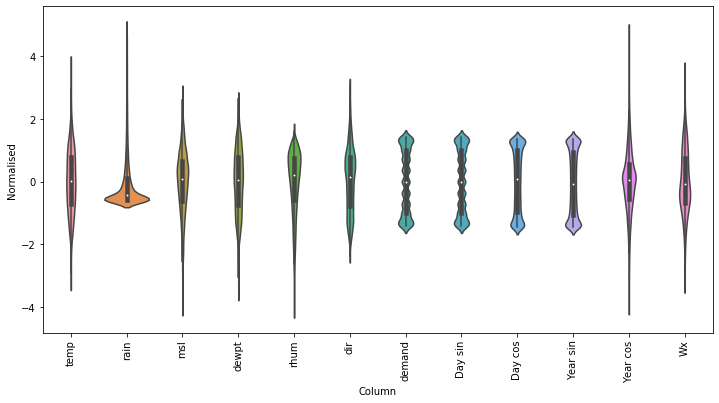

In [119]:
df_std = (data - train_mean) / train_std
df_std = df_std.melt(var_name='Column', value_name='Normalised')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='Normalised', data=df_std)
_ = ax.set_xticklabels(model_dataset.keys(), rotation=90)

### Model Evaluation

### Baseline

In [125]:
class WindowGenerator():
    def __init__(self, input_width, label_width, shift,
                train_df=train_df, val_df=val_df, test_df=test_df,
                pred_df=pred_df, label_columns=None):
        # Raw data
        self.train_df = train_df
        self.val_df = val_df
        self.test_df = test_df
        self.pred_df = pred_df
        
        # Label column
        self.label_columns = label_columns
        if label_columns is not None:
            self.label_columns_indices = {name: i for i, name in
                                         enumerate(label_columns)}
            self.coulmn_indices = {name: i for i, name in 
                                  enumerate(train_df.columns)}
            
        # Window parameters
        self.input_width = input_width
        self.label_width = label_width
        self.shift = shift
        
        self.total_window_size = input_width + shift
        
        self.input_slice = slice(0, input_width)
        self.input_indices = np.arange(self.total_window_size)[self.input_slice]
        
        self.label_start = self.total_window_size - self.label_width
        self.labels_slice = slice(self.label_start, None)
        self.label_indices = np.arange(self.total_window_size)[self.labels_slice]
        
    def __repr__(self):
        return '\n'.join([
            f'Total window size: {self.total_window_size}',
            f'Input indices: {self.input_indices}',
            f'Label indices: {self.label_indices}',
            f'Label column name(s): {self.label_columns}'
        ])

In [126]:
def split_window(self, features):
    inputs = features[:, self.input_slice, :]
    labels = features[:, self.labels_slice, :]
    if self.label_columns is not None:
        labels = tf.stack(
        [labels[:, :, {name: i for i, name in enumerate(train_df.columns)}[name]] for name in self.label_columns],
        axis = -1)
        
    # Shaping the data manually
    inputs.set_shape([None, self.input_width, None])
    labels.set_shape([None, self.label_width, None])
    return inputs, labels

WindowGenerator.split_window = split_window

In [128]:
def make_dataset(self, data):
    data = np.array(data, dtype=np.float32)
    ds = tf.keras.preprocessing.timeseries_dataset_from_array(
        data = data,
        targets = None,
        sequence_length = self.total_window_size,
        sequence_stride=1,
        shuffle=True,
        batch_size=32)
    
    ds = ds.map(self.split_window)
    return ds
WindowGenerator.make_dataset = make_dataset

In [129]:
@property
def train(self):
    return self.make_dataset(self.train_df)

@property
def val(self):
    return self.make_dataset(self.val_df)

@property
def test(self):
    return self.make_dataset(self.test_df)

@property
def pred(self):
    return self.make_dataset(self.pred_df)

WindowGenerator.train = train
WindowGenerator.val = val
WindowGenerator.test = test
WindowGenerator.pred = pred

In [130]:
OUT_STEPS = 24
multi_window = WindowGenerator(input_width=24,
                              label_width=OUT_STEPS,
                              shift=OUT_STEPS,
                              label_columns=['demand'])

multi_window

Total window size: 48
Input indices: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]
Label indices: [24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]
Label column name(s): ['demand']

In [137]:
MAX_EPOCHS = 20

def compile_and_fit(model, window, patience=2):
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                     patience=patience,
                                                     mode='min')
    
    model.compile(loss=tf.losses.MeanSquaredError(),
                 optimizer=tf.optimizers.Adam(),
                 metrics=[tf.metrics.MeanAbsoluteError(),tf.keras.metrics.RootMeanSquaredError()])
    
    log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + model.name
    tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
    
    history = model.fit(window.train, epochs=MAX_EPOCHS,
                       validation_data = window.val,
                       callbacks=[early_stopping, tensorboard_callback])
    return history

In [144]:
val_performance = {}
performance = {}

In [139]:
multi_linear_model = tf.keras.Sequential([
    tf.keras.layers.Lambda(lambda x: x[:, -1:, :]),
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                         kernel_initializer=tf.initializers.zeros()),
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

history_linear = compile_and_fit(multi_linear_model, multi_window)
val_performance['Linear'] = multi_linear_model.evaluate(multi_window.val)
performance['Linear'] = multi_linear_model.evaluate(multi_window.test, verbose=0)

Epoch 1/20
1441/1441 [==============================] - 5s 3ms/step - loss: 0.5173 - mean_absolute_error: 0.5837 - root_mean_squared_error: 0.7124 - val_loss: 0.2861 - val_mean_absolute_error: 0.3873 - val_root_mean_squared_error: 0.5349
Epoch 2/20
1441/1441 [==============================] - 4s 3ms/step - loss: 0.2580 - mean_absolute_error: 0.3964 - root_mean_squared_error: 0.5079 - val_loss: 0.2701 - val_mean_absolute_error: 0.3728 - val_root_mean_squared_error: 0.5197
Epoch 3/20
1441/1441 [==============================] - 4s 3ms/step - loss: 0.2524 - mean_absolute_error: 0.3902 - root_mean_squared_error: 0.5023 - val_loss: 0.2699 - val_mean_absolute_error: 0.3732 - val_root_mean_squared_error: 0.5195
Epoch 4/20
1441/1441 [==============================] - 4s 3ms/step - loss: 0.2523 - mean_absolute_error: 0.3902 - root_mean_squared_error: 0.5023 - val_loss: 0.2694 - val_mean_absolute_error: 0.3731 - val_root_mean_squared_error: 0.5191
Epoch 5/20
1441/1441 [==========================

In [180]:
%tensorboard --logdir /Users/greengodfitness/Desktop/TechFit/ds_project

In [146]:
multi_dense_model = tf.keras.Sequential([
    tf.keras.layers.Lambda(lambda x: x[:, -1:, :]),
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                         kernel_initializer=tf.initializers.zeros()),
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

history_dense = compile_and_fit(multi_dense_model, multi_window)
val_performance['Dense'] = multi_dense_model.evaluate(multi_window.val)
performance['Dense'] = multi_dense_model.evaluate(multi_window.test, verbose=0)

Epoch 1/20
1441/1441 [==============================] - 6s 4ms/step - loss: 0.2191 - mean_absolute_error: 0.3468 - root_mean_squared_error: 0.4566 - val_loss: 0.1181 - val_mean_absolute_error: 0.2615 - val_root_mean_squared_error: 0.3437
Epoch 2/20
1441/1441 [==============================] - 5s 4ms/step - loss: 0.1077 - mean_absolute_error: 0.2450 - root_mean_squared_error: 0.3281 - val_loss: 0.0990 - val_mean_absolute_error: 0.2339 - val_root_mean_squared_error: 0.3147
Epoch 3/20
1441/1441 [==============================] - 6s 4ms/step - loss: 0.0986 - mean_absolute_error: 0.2313 - root_mean_squared_error: 0.3139 - val_loss: 0.0954 - val_mean_absolute_error: 0.2284 - val_root_mean_squared_error: 0.3088
Epoch 4/20
1441/1441 [==============================] - 5s 3ms/step - loss: 0.0943 - mean_absolute_error: 0.2244 - root_mean_squared_error: 0.3071 - val_loss: 0.0994 - val_mean_absolute_error: 0.2335 - val_root_mean_squared_error: 0.3154
Epoch 5/20
179/179 [============================

In [147]:
CONV_WIDTH = 3
multi_conv_model = tf.keras.Sequential([
    tf.keras.layers.Lambda(lambda x: x[:, -CONV_WIDTH:, :]),
    tf.keras.layers.Conv1D(256, activation='relu', kernel_size=(CONV_WIDTH)),
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                         kernel_initializer=tf.initializers.zeros()),
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

history_conv = compile_and_fit(multi_conv_model, multi_window)
val_performance['Conv'] = multi_conv_model.evaluate(multi_window.val)
performance['Conv'] = multi_conv_model.evaluate(multi_window.test, verbose=0)

Epoch 1/20
1441/1441 [==============================] - 6s 4ms/step - loss: 0.2139 - mean_absolute_error: 0.3399 - root_mean_squared_error: 0.4496 - val_loss: 0.1004 - val_mean_absolute_error: 0.2413 - val_root_mean_squared_error: 0.3168
Epoch 2/20
1441/1441 [==============================] - 5s 3ms/step - loss: 0.1036 - mean_absolute_error: 0.2391 - root_mean_squared_error: 0.3219 - val_loss: 0.0979 - val_mean_absolute_error: 0.2354 - val_root_mean_squared_error: 0.3129
Epoch 3/20
1441/1441 [==============================] - 5s 3ms/step - loss: 0.0953 - mean_absolute_error: 0.2268 - root_mean_squared_error: 0.3087 - val_loss: 0.1086 - val_mean_absolute_error: 0.2517 - val_root_mean_squared_error: 0.3295
Epoch 4/20
1441/1441 [==============================] - 5s 3ms/step - loss: 0.0912 - mean_absolute_error: 0.2206 - root_mean_squared_error: 0.3020 - val_loss: 0.0947 - val_mean_absolute_error: 0.2310 - val_root_mean_squared_error: 0.3078
Epoch 5/20
1441/1441 [==========================

In [149]:
multi_lstm_model = tf.keras.Sequential([
    tf.keras.layers.LSTM(128, return_sequences=False),
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                         kernel_initializer=tf.initializers.zeros()),
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

history_lstm = compile_and_fit(multi_lstm_model, multi_window)
val_performance['LSTM'] = multi_lstm_model.evaluate(multi_window.val)
performance['LSTM'] = multi_lstm_model.evaluate(multi_window.test, verbose=0)

Epoch 1/20
1441/1441 [==============================] - 28s 18ms/step - loss: 0.1968 - mean_absolute_error: 0.3170 - root_mean_squared_error: 0.4271 - val_loss: 0.0820 - val_mean_absolute_error: 0.2102 - val_root_mean_squared_error: 0.2864
Epoch 2/20
1441/1441 [==============================] - 25s 17ms/step - loss: 0.0564 - mean_absolute_error: 0.1704 - root_mean_squared_error: 0.2374 - val_loss: 0.0680 - val_mean_absolute_error: 0.1713 - val_root_mean_squared_error: 0.2608
Epoch 3/20
1441/1441 [==============================] - 18s 13ms/step - loss: 0.0399 - mean_absolute_error: 0.1408 - root_mean_squared_error: 0.1998 - val_loss: 0.0381 - val_mean_absolute_error: 0.1355 - val_root_mean_squared_error: 0.1952
Epoch 4/20
1441/1441 [==============================] - 20s 14ms/step - loss: 0.0341 - mean_absolute_error: 0.1285 - root_mean_squared_error: 0.1846 - val_loss: 0.0360 - val_mean_absolute_error: 0.1297 - val_root_mean_squared_error: 0.1896
Epoch 5/20
1441/1441 [==================

In [170]:
class Feedback(tf.keras.Model):
    def __init__(self, units, out_steps):
        super().__init__()
        self.out_steps = out_steps
        self.units = units
        self.lstm_cell = tf.keras.layers.LSTMCell(units)
        self.lstm_rnn = tf.keras.layers.RNN(self.lstm_cell, return_state = True)
        self.dense = tf.keras.layers.Dense(num_features)

In [171]:
feedback_model = Feedback(units=32, out_steps=OUT_STEPS)

In [172]:
def warmup(self, inputs):
    x, *state = self.lstm_rnn(inputs)
    prediction = self.dense(x)
    return prediction, state
Feedback.warmup = warmup

In [173]:
def call(self, inputs, training=None):
    predictions = []
    prediction, state = self.warmup(inputs)
    
    predictions.append(prediction)
    
    for n in range(1, self.out_steps):
        x = prediction
        x, state = self.lstm_cell(x, states=state,
                                 training=training)
        prediction = self.dense(x)
        predictions.append(prediction)
        
    predictions = tf.stack(predictions)
    predictions = tf.transpose(predictions, [1, 0, 2])
    return predictions

Feedback.call = call

In [174]:
history_ar = compile_and_fit(feedback_model, multi_window)
val_performance['AR LSTM'] = feedback_model.evaluate(multi_window.val)
performance['AR LSTM'] = feedback_model.evaluate(multi_window.test, verbose=0)

Epoch 1/20
1441/1441 [==============================] - 23s 13ms/step - loss: 0.3311 - mean_absolute_error: 0.4231 - root_mean_squared_error: 0.5559 - val_loss: 0.1087 - val_mean_absolute_error: 0.2480 - val_root_mean_squared_error: 0.3297
Epoch 2/20
1441/1441 [==============================] - 17s 12ms/step - loss: 0.0968 - mean_absolute_error: 0.2319 - root_mean_squared_error: 0.3111 - val_loss: 0.1004 - val_mean_absolute_error: 0.2326 - val_root_mean_squared_error: 0.3169
Epoch 3/20
1441/1441 [==============================] - 14s 10ms/step - loss: 0.0749 - mean_absolute_error: 0.2018 - root_mean_squared_error: 0.2735 - val_loss: 0.0672 - val_mean_absolute_error: 0.1918 - val_root_mean_squared_error: 0.2593
Epoch 4/20
1441/1441 [==============================] - 15s 10ms/step - loss: 0.0613 - mean_absolute_error: 0.1826 - root_mean_squared_error: 0.2476 - val_loss: 0.0650 - val_mean_absolute_error: 0.1885 - val_root_mean_squared_error: 0.2549
Epoch 5/20
1441/1441 [==================

### Model Tuning

### LSTM

Glorot uniform initializer, also called Xavier uniform initializer. It draws samples from a uniform distribution within [-limit, limit] where limit is sqrt(6 / (fan_in + fan_out)) where fan_in is the number of input units in the weight tensor and fan_out is the number of output units in the weight tensor.

In [175]:
initializer = tf.keras.initializers.GlorotUniform()
multi_lstm_model_0 = tf.keras.Sequential([
    tf.keras.layers.GRU(128, return_sequences=False),
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                          kernel_initializer=initializer),
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

MAX_EPOCHS = 20

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                    patience=2,
                                                    mode='min')

multi_lstm_model_0.compile(loss=tf.losses.MeanSquaredError(),
            optimizer=tf.optimizers.Adam(),
            metrics=[tf.metrics.MeanAbsoluteError(),tf.keras.metrics.RootMeanSquaredError()])

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + nameof(multi_lstm_model_0)
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

history_lstm_0 = multi_lstm_model_0.fit(multi_window.train, epochs=MAX_EPOCHS,
                    validation_data=multi_window.val,
                    callbacks=[early_stopping,tensorboard_callback])

Epoch 1/20
1441/1441 [==============================] - 22s 14ms/step - loss: 0.1985 - mean_absolute_error: 0.3194 - root_mean_squared_error: 0.4299 - val_loss: 0.0731 - val_mean_absolute_error: 0.2037 - val_root_mean_squared_error: 0.2703
Epoch 2/20
1441/1441 [==============================] - 20s 14ms/step - loss: 0.0629 - mean_absolute_error: 0.1834 - root_mean_squared_error: 0.2506 - val_loss: 0.0518 - val_mean_absolute_error: 0.1650 - val_root_mean_squared_error: 0.2276
Epoch 3/20
1441/1441 [==============================] - 21s 14ms/step - loss: 0.0435 - mean_absolute_error: 0.1502 - root_mean_squared_error: 0.2085 - val_loss: 0.0374 - val_mean_absolute_error: 0.1414 - val_root_mean_squared_error: 0.1934
Epoch 4/20
1441/1441 [==============================] - 22s 16ms/step - loss: 0.0354 - mean_absolute_error: 0.1344 - root_mean_squared_error: 0.1882 - val_loss: 0.0331 - val_mean_absolute_error: 0.1323 - val_root_mean_squared_error: 0.1820
Epoch 5/20
1441/1441 [==================

In [181]:
multi_lstm_model_1 = tf.keras.Sequential([
    tf.keras.layers.LSTM(128, return_sequences=False),
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                          kernel_initializer=tf.initializers.zeros()),
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

MAX_EPOCHS = 30

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='loss',
                                                    patience=2,
                                                    mode='auto',
                                                    restore_best_weights=True)

multi_lstm_model_1.compile(loss=tf.losses.MeanSquaredError(),
            optimizer=tf.keras.optimizers.SGD(learning_rate=0.05),
            metrics=[tf.metrics.MeanAbsoluteError(),tf.keras.metrics.RootMeanSquaredError()])

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + nameof(multi_lstm_model_1)
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

history_lstm_1 = multi_lstm_model_1.fit(multi_window.train, epochs=MAX_EPOCHS,
                    validation_data=multi_window.val,
                    callbacks=[early_stopping,tensorboard_callback])

Epoch 1/30
1441/1441 [==============================] - 25s 16ms/step - loss: 0.8305 - mean_absolute_error: 0.7619 - root_mean_squared_error: 0.9086 - val_loss: 0.2693 - val_mean_absolute_error: 0.3947 - val_root_mean_squared_error: 0.5189
Epoch 2/30
1441/1441 [==============================] - 21s 15ms/step - loss: 0.2351 - mean_absolute_error: 0.3881 - root_mean_squared_error: 0.4847 - val_loss: 0.2016 - val_mean_absolute_error: 0.3328 - val_root_mean_squared_error: 0.4490
Epoch 3/30
1441/1441 [==============================] - 20s 14ms/step - loss: 0.1944 - mean_absolute_error: 0.3480 - root_mean_squared_error: 0.4408 - val_loss: 0.1626 - val_mean_absolute_error: 0.2973 - val_root_mean_squared_error: 0.4032
Epoch 4/30
1441/1441 [==============================] - 23s 16ms/step - loss: 0.1545 - mean_absolute_error: 0.3050 - root_mean_squared_error: 0.3930 - val_loss: 0.1257 - val_mean_absolute_error: 0.2596 - val_root_mean_squared_error: 0.3546
Epoch 5/30
1441/1441 [==================

In [182]:
initializer = tf.keras.initializers.GlorotUniform()
multi_lstm_model_2 = tf.keras.Sequential([
    tf.keras.layers.LSTM(128, return_sequences=True),
    tf.keras.layers.Dropout(.2, input_shape=(2,)),
    tf.keras.layers.LSTM(128, return_sequences=False),
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                          kernel_initializer=initializer),
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

MAX_EPOCHS = 30

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                    patience=4,
                                                    mode='min')

multi_lstm_model_2.compile(loss=tf.losses.MeanSquaredError(),
            optimizer=tf.keras.optimizers.Adam(),
            metrics=[tf.metrics.MeanAbsoluteError(),tf.keras.metrics.RootMeanSquaredError()])

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + nameof(multi_lstm_model_2)
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

history_lstm_2 = multi_lstm_model_2.fit(multi_window.train, epochs=MAX_EPOCHS,
                    validation_data=multi_window.val,
                    callbacks=[early_stopping,tensorboard_callback])

Epoch 1/30
1441/1441 [==============================] - 46s 30ms/step - loss: 0.1895 - mean_absolute_error: 0.3133 - root_mean_squared_error: 0.4209 - val_loss: 0.0683 - val_mean_absolute_error: 0.1872 - val_root_mean_squared_error: 0.2614
Epoch 2/30
1441/1441 [==============================] - 43s 30ms/step - loss: 0.0553 - mean_absolute_error: 0.1704 - root_mean_squared_error: 0.2350 - val_loss: 0.0432 - val_mean_absolute_error: 0.1467 - val_root_mean_squared_error: 0.2079
Epoch 3/30
1441/1441 [==============================] - 42s 29ms/step - loss: 0.0372 - mean_absolute_error: 0.1377 - root_mean_squared_error: 0.1929 - val_loss: 0.0346 - val_mean_absolute_error: 0.1295 - val_root_mean_squared_error: 0.1859
Epoch 4/30
1441/1441 [==============================] - 43s 30ms/step - loss: 0.0300 - mean_absolute_error: 0.1232 - root_mean_squared_error: 0.1733 - val_loss: 0.0322 - val_mean_absolute_error: 0.1240 - val_root_mean_squared_error: 0.1793
Epoch 5/30
1441/1441 [==================

In [183]:
initializer = tf.keras.initializers.GlorotUniform()
multi_lstm_model_3 = tf.keras.Sequential([
    tf.keras.layers.LSTM(128, return_sequences=False),
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                          kernel_initializer=initializer),
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

MAX_EPOCHS = 30

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                    patience=4,
                                                    mode='min')

multi_lstm_model_3.compile(loss=tf.losses.MeanSquaredError(),
            optimizer=tf.keras.optimizers.Adam(),
            metrics=[tf.metrics.MeanAbsoluteError(),tf.keras.metrics.RootMeanSquaredError()])

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + " " + nameof(multi_lstm_model_3)
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

history_lstm_3 = multi_lstm_model_3.fit(multi_window.train, epochs=MAX_EPOCHS,
                    validation_data=multi_window.val,
                    callbacks=[early_stopping,tensorboard_callback])

Epoch 1/30
1441/1441 [==============================] - 25s 16ms/step - loss: 0.2016 - mean_absolute_error: 0.3224 - root_mean_squared_error: 0.4334 - val_loss: 0.0743 - val_mean_absolute_error: 0.2027 - val_root_mean_squared_error: 0.2727
Epoch 2/30
1441/1441 [==============================] - 21s 15ms/step - loss: 0.0614 - mean_absolute_error: 0.1794 - root_mean_squared_error: 0.2477 - val_loss: 0.0546 - val_mean_absolute_error: 0.1685 - val_root_mean_squared_error: 0.2336
Epoch 3/30
1441/1441 [==============================] - 21s 14ms/step - loss: 0.0428 - mean_absolute_error: 0.1468 - root_mean_squared_error: 0.2068 - val_loss: 0.0386 - val_mean_absolute_error: 0.1416 - val_root_mean_squared_error: 0.1965
Epoch 4/30
1441/1441 [==============================] - 21s 14ms/step - loss: 0.0346 - mean_absolute_error: 0.1306 - root_mean_squared_error: 0.1861 - val_loss: 0.0508 - val_mean_absolute_error: 0.1562 - val_root_mean_squared_error: 0.2255
Epoch 5/30
1441/1441 [==================

In [190]:
x_input = pred_df_actual.to_numpy()
x_input = x_input.reshape((1, OUT_STEPS, 12))
y_pred = multi_lstm_model_3.predict(multi_window.pred)
y_pred_ar = feedback_model.predict(multi_window.pred)
y_future_lstm = multi_lstm_model_3.predict(x_input, verbose=0)
y_future_ar = feedback_model.predict(x_input, verbose=0)

In [193]:
df = pd.DataFrame([])
df = pd.DataFrame(y_pred[-1],columns=list(pred_df_actual.columns.values), index=pred_df_actual.index)
df1 = pd.DataFrame([])
df1 = pd.DataFrame(y_pred_ar[-1],columns=list(pred_df_actual.columns.values),index=pred_df_actual.index)
df3 = pd.DataFrame([])
df3 = pd.DataFrame(y_future_ar[-1],columns=list(future_pred.columns.values), index=future_pred.index)
df2 = pd.DataFrame([])
df2 = pd.DataFrame(y_future_lstm[-1],columns=list(future_pred.columns.values), index=future_pred.index)

In [194]:
actual = pred_df_actual * train_std + train_mean
df = df * train_std + train_mean
df1 = df1 * train_std + train_mean
train = train_df * train_std + train_mean
val = val_df * train_std + train_mean
test = test_df * train_std + train_mean
df2 = df2 * train_std + train_mean
df3 = df3 * train_std + train_mean
future_pred_inv = future_pred * train_std + train_mean

In [196]:
date_train = train.index
date_val = val.index
date_test = test.index
date_predict_lstm = df.index
date_predict_ar = df1.index
date_actual = actual.index
date_predict_lstm1 = df2.index
date_predict_ar1 = df3.index
date_actual1 = future_pred_inv.index

train_plot = train['demand'].values
val_plot = val['demand'].values
test_plot = test['demand'].values
predict_plot_lstm = df['demand'].values
predict_plot_ar = df1['demand'].values
predict_plot_actual = actual['demand'].values
predict_plot_lstm1 = df2['demand'].values
predict_plot_ar1 = df3['demand'].values
predict_plot_actual1 = future_pred_inv['demand'].values

trace1 = go.Scatter(
    x = date_train,
    y = train_plot,
    mode = 'lines',
    name = 'Training Data',
    line = dict(color=('rgb(66, 134, 244)'), width=2)
)
trace2 = go.Scatter(
    x = date_val,
    y = val_plot,
    mode = 'lines',
    name = 'Validation Data',
    line = dict(color=('rgb(0, 76, 153)'), width=2)
)
trace3 = go.Scatter(
    x = date_test,
    y = test_plot,
    mode = 'lines',
    name = 'Test Data',
    line = dict(color=('rgb(0, 51, 102)'), width=2)
)
trace4 = go.Scatter(
    x = date_actual,
    y = predict_plot_actual,
    mode = 'lines',
    name = 'Actuals 30/7',
    line = dict(color=('rgb(0, 0, 0)'), width=2, dash='dash')
)
trace5 = go.Scatter(
    x = date_predict_lstm,
    y = predict_plot_lstm,
    mode = 'lines',
    name = 'Predictions(LSTM) 30/7',
    line = dict(color=('rgb(255, 0, 0)'), width=2)
)
trace6 = go.Scatter(
    x = date_predict_ar,
    y = predict_plot_ar,
    mode = 'lines',
    name = 'Predictions(AR) 30/7',
    line = dict(color=('rgb(66, 244, 155)'), width=2)
)
trace7 = go.Scatter(
    x = date_predict_lstm1,
    y = predict_plot_lstm1,
    mode = 'lines',
    name = 'Predictions(LSTM) 31/7',
    line = dict(color=('rgb(255, 0, 0)'), width=2)
)
trace8 = go.Scatter(
    x = date_predict_ar1,
    y = predict_plot_ar1,
    mode = 'lines',
    name = 'Predictions(AR) 31/7',
    line = dict(color=('rgb(66, 244, 155)'), width=2)
)
trace9 = go.Scatter(
    x = arima_date_future,
    y = arima_prediction,
    mode = 'lines',
    name = 'Predictions(Arima)',
    line = dict(color=('rgb(0, 153, 153)'), width=2)
)
trace10 = go.Scatter(
    x = date_actual1,
    y = predict_plot_actual1,
    mode = 'lines',
    name = 'Actuals 31/7',
    line = dict(color=('rgb(0, 0, 0)'), width=2, dash='dash')
)
data = [trace1,trace2,trace3,trace4,trace5,trace6,trace7,trace8,trace9,trace10]
layout = go.Layout(
    title = "Predictions",
    xaxis = {'title' : "Date"},
    yaxis = {'title' : "Demand"}
)
fig = go.Figure(data=data, layout=layout)
fig.show()